<a href="https://colab.research.google.com/github/fun2play/BU_RISE_Project/blob/main/comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install HFODetector


In [3]:
import numpy as np
import mne
import matplotlib.pyplot as plt
import pandas as pd
from HFODetector import ste
from pathlib import Path

In [4]:
import mne
raw = mne.io.read_raw_edf("sub-01_ses-01_task-hfo_run-01_eeg.edf", preload=True)
print(raw.info['sfreq'])  # should print 1024.0

Extracting EDF parameters from /home/user96/sub-01_ses-01_task-hfo_run-01_eeg.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 599999  =      0.000 ...   300.000 secs...
2000.0


In [5]:

if __name__ == "__main__":
    edf_path = "sub-01_ses-01_task-hfo_run-01_eeg.edf" #change this to your edf path
    detector = ste.STEDetector(
        sample_freq=2000,
        filter_freq=[80, 500],
        rms_window=3*1e-3,
        min_window=6*1e-3,
        min_gap=10 * 1e-3,
        epoch_len=600,
        min_osc=6,
        rms_thres=5,
        peak_thres=3,
        n_jobs=32,
        front_num=1
    )
    channel_names, start_end = detector.detect_edf(edf_path)
    # channel_names is a list that is the same length as the number of channels in the edf
    # start_end is a nested list with the same length as channel_names. start_end[i][j][0] and start_end[i][j][1]
    # will give the start and end index respectively for the jth detected HFO in channel channel_names[i]
    channel_names = np.concatenate([[channel_names[i]]*len(start_end[i]) for i in range(len(channel_names))])
    start_end = [start_end[i] for i in range(len(start_end)) if len(start_end[i])>0]
    start_end = np.concatenate(start_end)
    HFO_ste_df = pd.DataFrame({"channel":channel_names,"start":start_end[:,0],"end":start_end[:,1]})

Extracting EDF parameters from /home/user96/sub-01_ses-01_task-hfo_run-01_eeg.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


100%|████████████████████████████████████████| 51.0/51.0 [00:01<00:00, 47.2it/s]


In [6]:
start_end

array([[365560, 365616],
       [365743, 365836],
       [340187, 340224],
       [365558, 365618],
       [365741, 365840],
       [365570, 365710],
       [212414, 212458],
       [365560, 365605],
       [365735, 365838],
       [     0,     27],
       [340189, 340233],
       [107757, 107801],
       [238968, 239008],
       [507408, 507450],
       [349798, 349848],
       [596712, 596749],
       [365559, 365646],
       [365741, 365839],
       [286226, 286264],
       [340188, 340224],
       [365570, 365629],
       [365650, 365707],
       [426007, 426043],
       [     0,     26]])

In [7]:
raw.pick("eeg")

data, times = raw.get_data(return_times=True)
chan_names = raw.ch_names

In [24]:
from scipy.io import savemat
raw.pick('eeg')  # drop EOG, EMG, etc.

# 2. Extract data array, times, and channel names
data, times = raw.get_data(return_times=True)
chan_names = raw.ch_names

# 2) Notch at 60 Hz + harmonics
#raw.notch_filter(freqs=[60., 120., 180.], picks='all')

# 3) High-pass at 1 Hz to kill slow drifts
raw.filter(l_freq=1.0, h_freq=None, picks='all')

# 4. Re-extract now-filtered data
data, times = raw.get_data(return_times=True)

# 5. Remove channel-wise mean to center each trace at zero
import numpy as np
mean_per_chan = np.mean(data, axis=1, keepdims=True)
data_centered = data - mean_per_chan



# 3. Write to .mat
savemat_path = 'cleaned_060_ictal_1_ieeg.mat'
savemat(savemat_path, {
    'data': data_centered,
    'times': times,
    'chan_names': chan_names
})
print(f"Saved EEG to {savemat_path}")

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Filter length: 6601 samples (3.300 s)

Saved EEG to cleaned_060_ictal_1_ieeg.mat


IndexError: index 24 is out of bounds for axis 0 with size 24

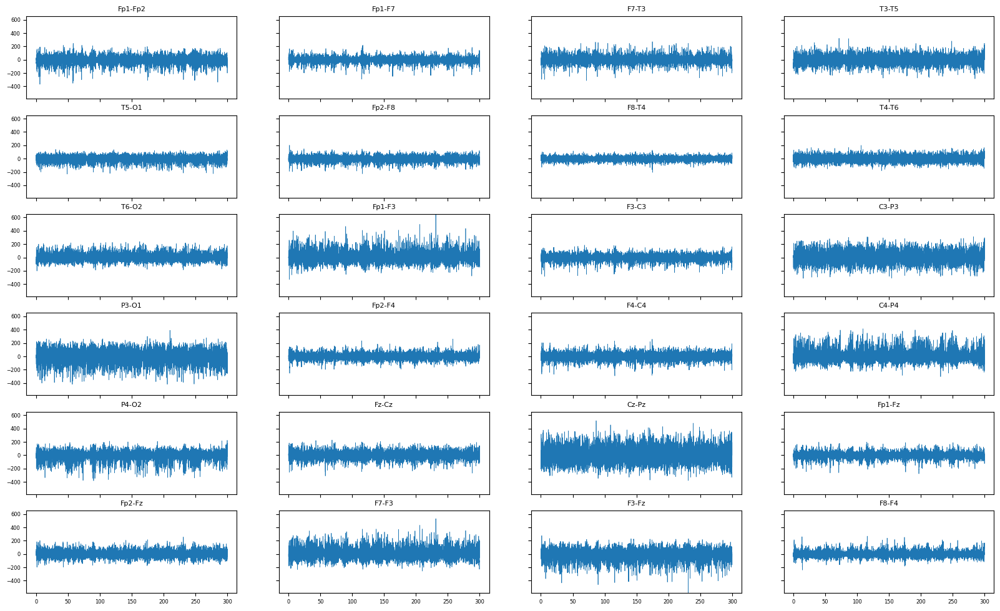

In [27]:
n_channels = data.shape[0]
n_plots    = min(30, n_channels)
n_rows, n_cols = 6, 4

fig, axes = plt.subplots(n_rows, n_cols,
                         figsize=(20, 12),
                         sharex=True, sharey=True)
axes = axes.flatten()

for i in range(n_plots):
    ax = axes[i]
    ax.plot(times, data[i], linewidth=0.5)
    ax.set_title(chan_names[i], fontsize=8)
    ax.tick_params(axis='both', which='major', labelsize=6)
    ax.set_ylim(data.min(), data.max())  # common y‐range

# Turn off any unused subplots
for ax in axes[n_plots:]:
    ax.axis('off')

fig.tight_layout()
plt.subplots_adjust(hspace=0.4, wspace=0.3)
plt.show()

In [28]:
from spectral_connectivity import Multitaper, Connectivity
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

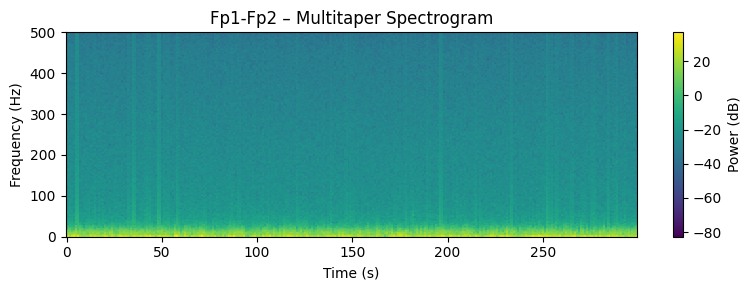

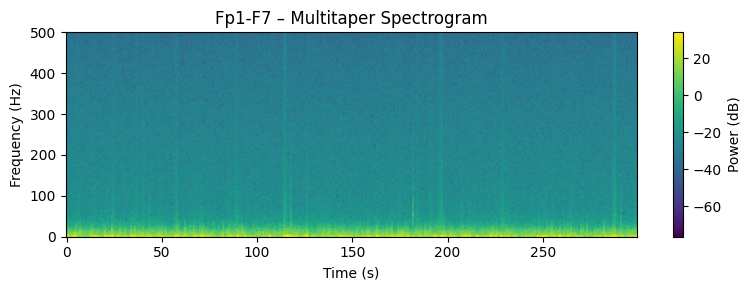

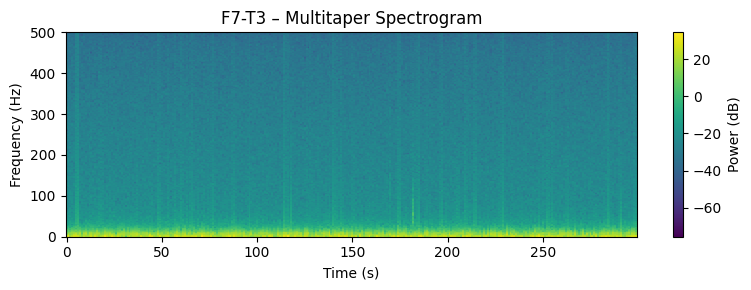

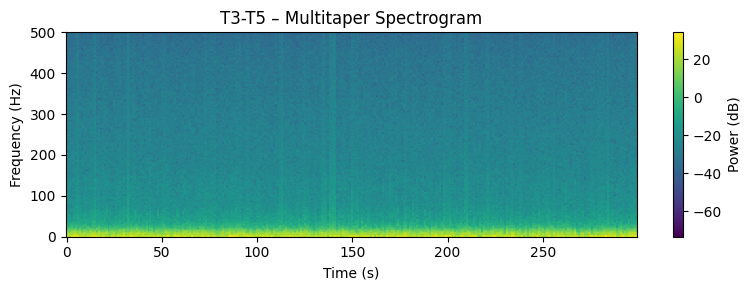

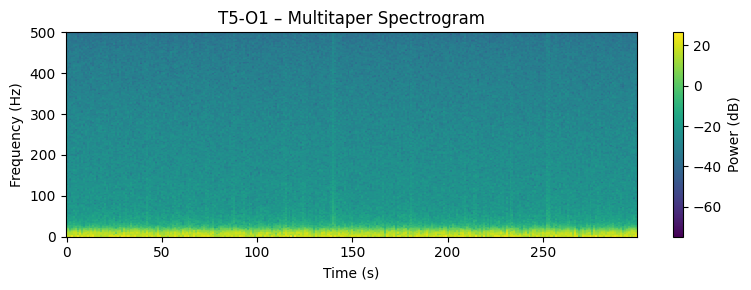

...

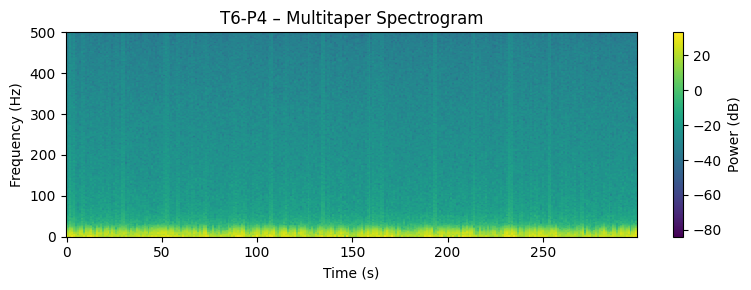

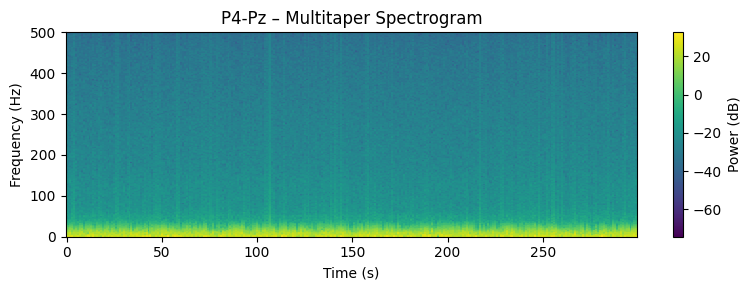

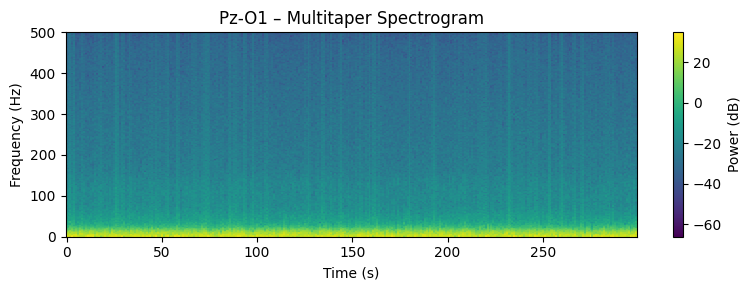

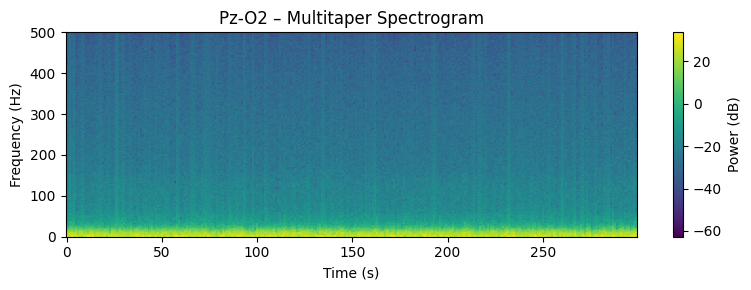

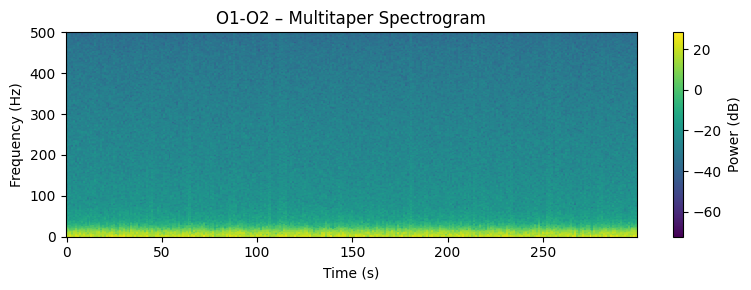

In [29]:
# 3) Set parameters
fs           = raw.info['sfreq']      # sampling rate in Hz
freq_limit   = 500                    # max frequency to display
tw_duration  = 1.0                    # window length in seconds
tw_step      = 1.0                    # step between windows in seconds
tb_product   = 3.0                    # time–bandwidth product for taper

# 4) Loop through channels (here up to the first 36)
for ch_idx, ch_name in enumerate(chan_names[:36]):
    signal = data[ch_idx, :]  # 1D array of samples for this channel

    # 4a) Build Multitaper object
    mt = Multitaper(
        signal,
        sampling_frequency=fs,
        time_halfbandwidth_product=tb_product,
        time_window_duration=tw_duration,
        time_window_step=tw_step,
        start_time=0.0
    )

    # 4b) Compute connectivity (includes power spectrum)
    conn = Connectivity.from_multitaper(mt)

    # 4c) Extract spectrogram data
    power = conn.power().squeeze().T          # shape: (n_freqs, n_time_windows)
    freqs = conn.frequencies                  # length n_freqs
    times_spec = conn.time                    # length n_time_windows

    # 5) Plot
    plt.figure(figsize=(8, 3))
    plt.pcolormesh(
        times_spec,
        freqs,
        10 * np.log10(power),
        shading='auto'
    )
    plt.title(f"{ch_name} – Multitaper Spectrogram", fontsize=12)
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")
    plt.ylim(0, freq_limit)
    plt.colorbar(label="Power (dB)")
    plt.tight_layout()
    plt.show()

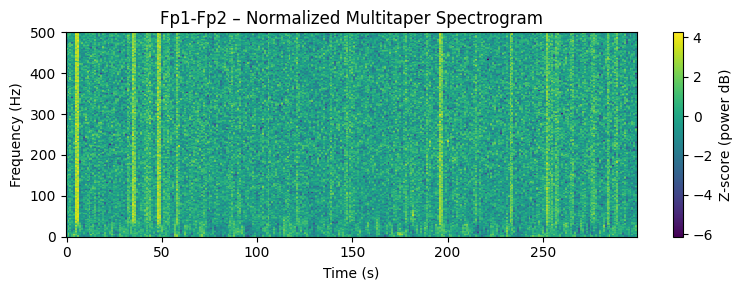

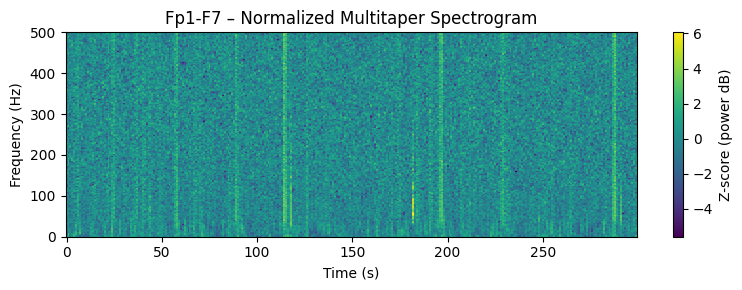

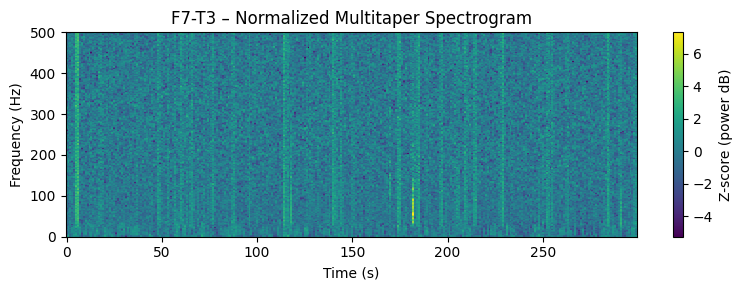

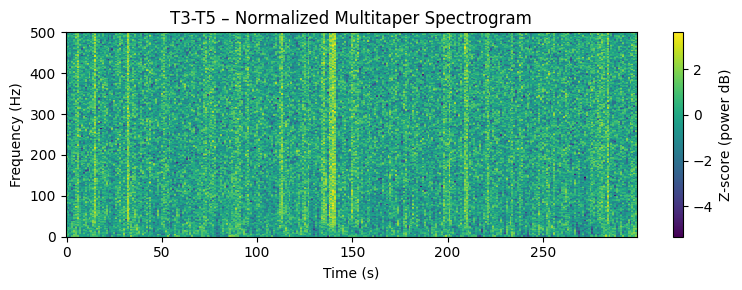

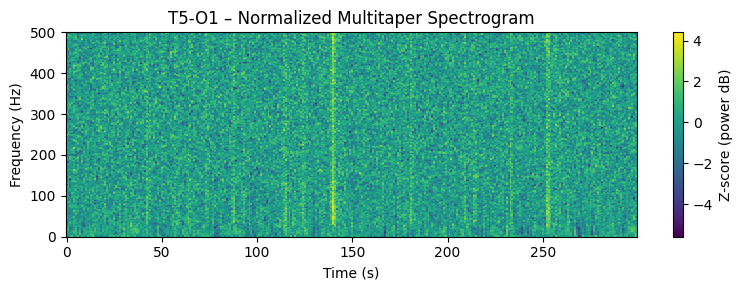

...

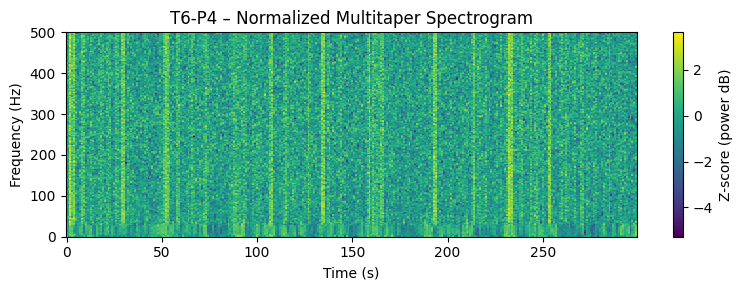

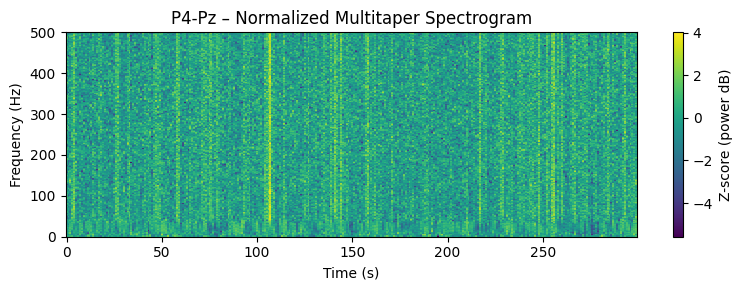

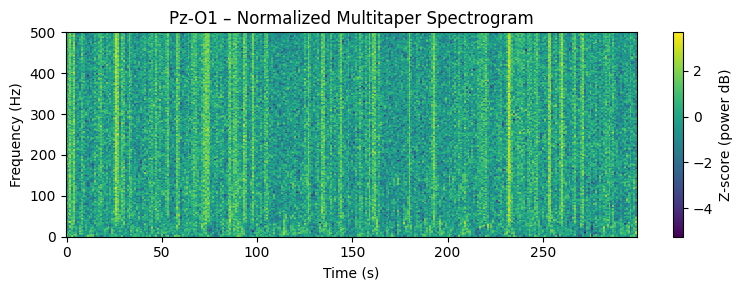

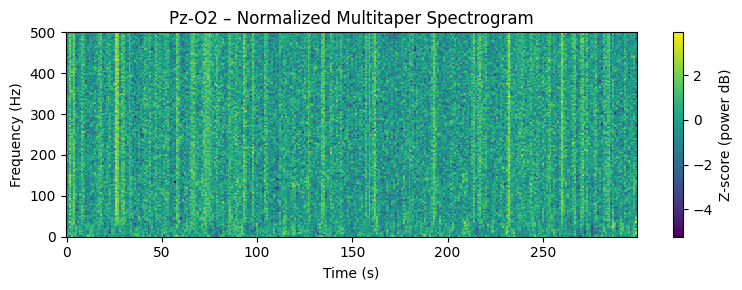

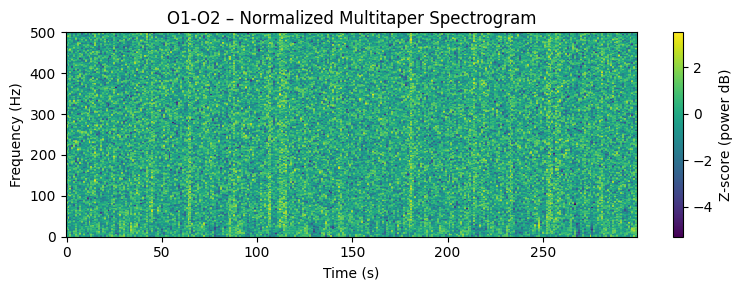

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from spectral_connectivity import Multitaper, Connectivity

# 0) … (your setup: fs, data, chan_names, etc.)

# 1) Set parameters
fs           = raw.info['sfreq']
freq_limit   = 500
tw_duration  = 1.0
tw_step      = 1.0
tb_product   = 3.0

# 2) Loop through channels (up to first 36)
for ch_idx, ch_name in enumerate(chan_names[:36]):
    signal = data[ch_idx, :]

    # 2a) Build Multitaper object
    mt = Multitaper(
        signal,
        sampling_frequency=fs,
        time_halfbandwidth_product=tb_product,
        time_window_duration=tw_duration,
        time_window_step=tw_step,
        start_time=0.0
    )

    # 2b) Compute connectivity (includes power spectrum)
    conn = Connectivity.from_multitaper(mt)

    # 2c) Extract spectrogram data
    power = conn.power().squeeze().T      # shape: (n_freqs, n_time_windows)
    freqs = conn.frequencies
    times_spec = conn.time

    # 2d) Convert to dB and z-score normalize *per frequency* (across time)
    power_db    = 10 * np.log10(power)
    mean_per_f  = power_db.mean(axis=1, keepdims=True)
    std_per_f   = power_db.std(axis=1, keepdims=True)
    power_norm  = (power_db - mean_per_f) / std_per_f

    # 2e) Plot normalized spectrogram
    plt.figure(figsize=(8, 3))
    plt.pcolormesh(
        times_spec,
        freqs,
        power_norm,
        shading='auto'
    )
    plt.title(f"{ch_name} – Normalized Multitaper Spectrogram", fontsize=12)
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")
    plt.ylim(0, freq_limit)
    cbar = plt.colorbar(label="Z-score (power dB)")
    plt.tight_layout()
    plt.show()


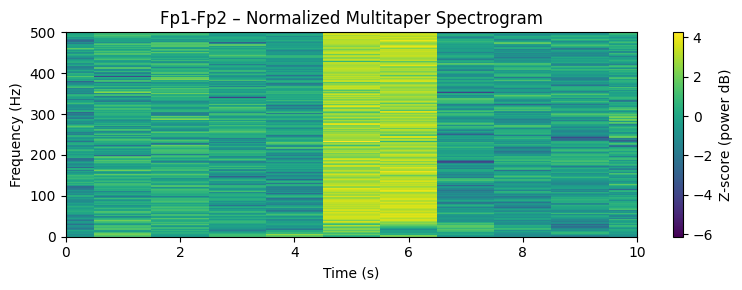

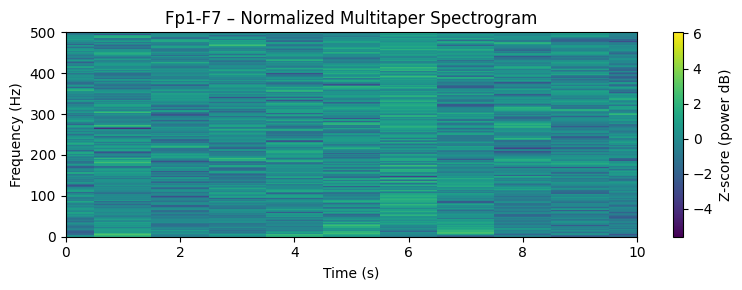

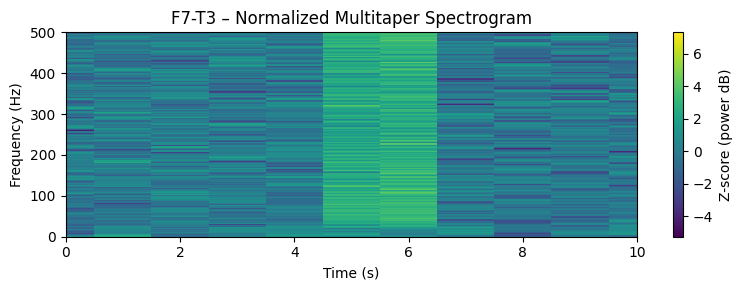

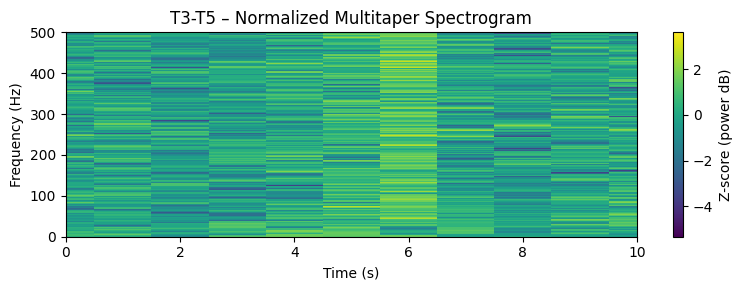

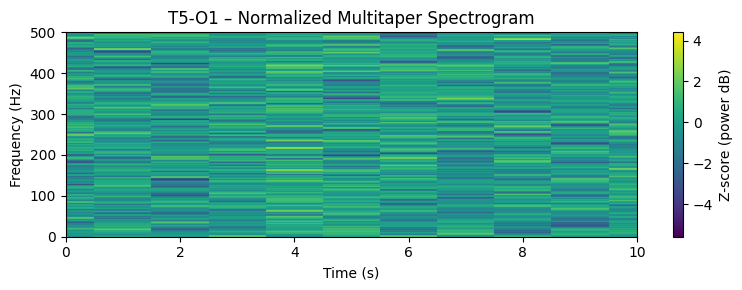

...

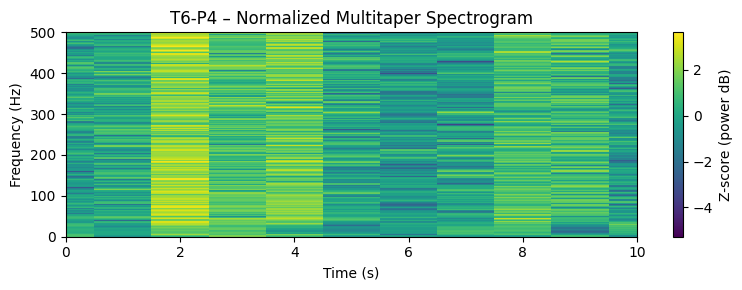

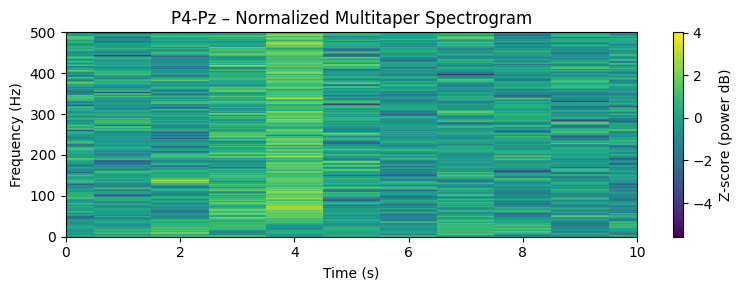

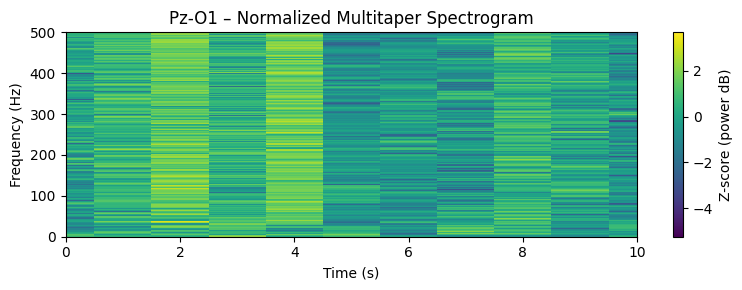

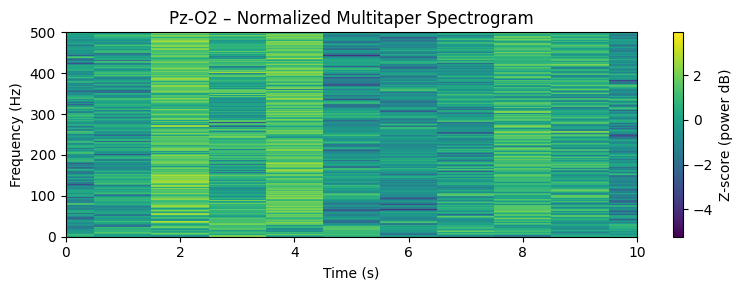

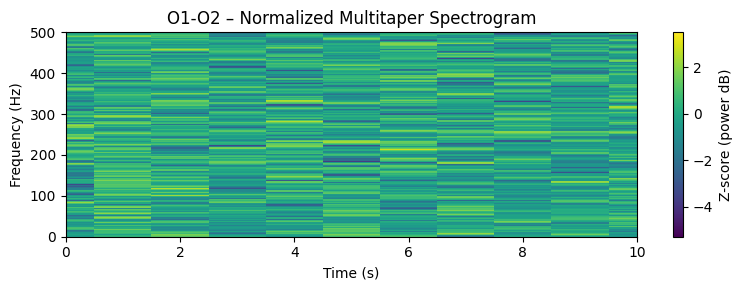

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from spectral_connectivity import Multitaper, Connectivity

# 0) … (your setup: fs, data, chan_names, etc.)

# 1) Set parameters
fs           = raw.info['sfreq']
freq_limit   = 500
tw_duration  = 1.0
tw_step      = 1.0
tb_product   = 3.0

# 2) Loop through channels (up to first 36)
for ch_idx, ch_name in enumerate(chan_names[:36]):
    signal = data[ch_idx, :]

    # 2a) Build Multitaper object
    mt = Multitaper(
        signal,
        sampling_frequency=fs,
        time_halfbandwidth_product=tb_product,
        time_window_duration=tw_duration,
        time_window_step=tw_step,
        start_time=0.0
    )

    # 2b) Compute connectivity (includes power spectrum)
    conn = Connectivity.from_multitaper(mt)

    # 2c) Extract spectrogram data
    power = conn.power().squeeze().T      # shape: (n_freqs, n_time_windows)
    freqs = conn.frequencies
    times_spec = conn.time

    # 2d) Convert to dB and z-score normalize *per frequency* (across time)
    power_db    = 10 * np.log10(power)
    mean_per_f  = power_db.mean(axis=1, keepdims=True)
    std_per_f   = power_db.std(axis=1, keepdims=True)
    power_norm  = (power_db - mean_per_f) / std_per_f

    # 2e) Plot normalized spectrogram
    plt.figure(figsize=(8, 3))
    plt.pcolormesh(
        times_spec,
        freqs,
        power_norm,
        shading='auto'
    )
    plt.title(f"{ch_name} – Normalized Multitaper Spectrogram", fontsize=12)
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")
    plt.ylim(0, freq_limit)
    plt.xlim(0, 10)
    plt.colorbar(label="Z-score (power dB)")
    plt.tight_layout()
    plt.show()

In [32]:
import pandas as pd

# Load file
hfo_df = pd.read_csv("sub-01_ses-01_task-hfo_run-01_events.tsv", sep="\t")

hfo_df.head()

,nChannel,strChannelName,indStart,indStop,indDuration,Event_RMS,Window_RMS,EventPeak2Peak,SNR,Amplpp,PowerTrough,Ftrough,PowmaxFR,fmax_FR,EvPassRejection
0,1,Fp1-Fp2,575329,575379,50,1.952451,1.061534,6.503785,3.382925,7.442305,0.429407,172.0,0.649347,171,0
1,2,Fp1-F7,236901,236984,83,7.704780,1.176138,46.224505,42.914486,46.224505,0.962371,NaN,4.425388,300,0
2,2,Fp1-F7,365682,365853,171,7.411193,1.795490,38.289513,17.037674,38.289513,1.701670,83.0,3.779875,82,0
3,3,F7-T3,236902,236990,88,7.386052,1.166535,44.455175,40.089370,44.455175,1.864868,83.0,1.113908,82,0
4,3,F7-T3,340160,340263,103,4.486742,1.220474,23.794207,13.514659,23.794207,0.969517,137.0,2.109847,136,1


Text(0, 0.5, 'Amplitude')

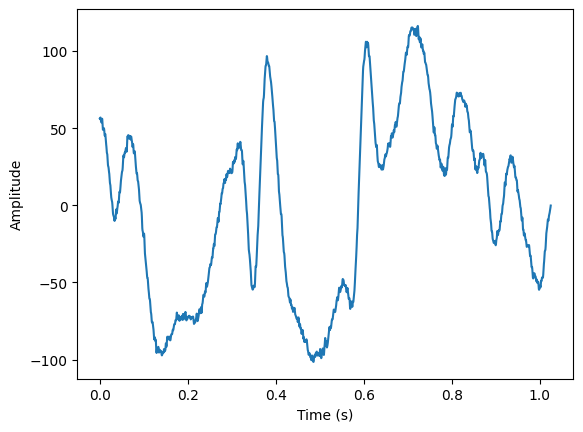

In [170]:

buffer = fs * 0.5 # 0.5 seconds around the window
val_1 = int(575329 - buffer) # value comes from data frame
val_2 = int(575379 + buffer) # value comes from data frame


signal_test = data[0, val_1:val_2]

time_1 = np.linspace(0, len(signal_test) / fs, len(signal_test))


plt.plot(time_1, signal_test)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")





(0.0, 500.0)

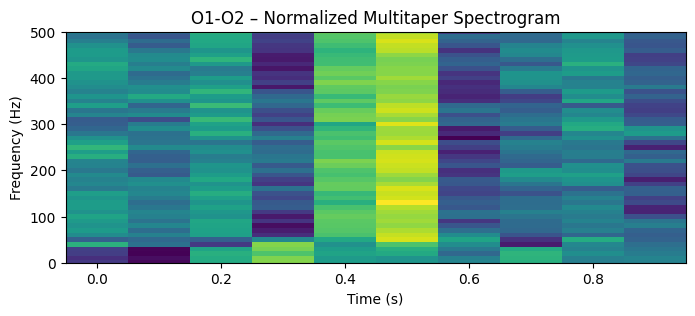

In [171]:



tw_duration = 0.1

mt = Multitaper(
    signal_test,
    sampling_frequency=fs,
    time_halfbandwidth_product=tb_product,
    time_window_duration=tw_duration,
    start_time=0.0
)

# 2b) Compute connectivity
conn = Connectivity.from_multitaper(mt)

# 2c) Extract spectrogram data
power = conn.power().squeeze().T
freqs = conn.frequencies
times_spec = conn.time

# 2d) Normalize
power_db = 10 * np.log10(power)
mean_per_f = power_db.mean(axis=1, keepdims=True)
std_per_f = power_db.std(axis=1, keepdims=True)
power_norm = (power_db - mean_per_f) / std_per_f


fig, ax = plt.subplots(figsize=(8, 3))
im = ax.pcolormesh(times_spec, freqs, power_norm, shading='auto')
ax.set_title(f"{ch_name} – Normalized Multitaper Spectrogram", fontsize=12)
ax.set_xlabel("Time (s)")
ax.set_ylabel("Frequency (Hz)")
ax.set_ylim(0, freq_limit)



In [35]:
# Strip spaces in column names
hfo_df.rename(columns=lambda x: x.strip(), inplace=True)

# Rename for consistency
hfo_df.rename(columns={"strChannelName": "channel", "indStart": "indStart"}, inplace=True)

# Convert sample index to seconds
fs = 2000
hfo_df["time_s"] = hfo_df["indStart"] / fs

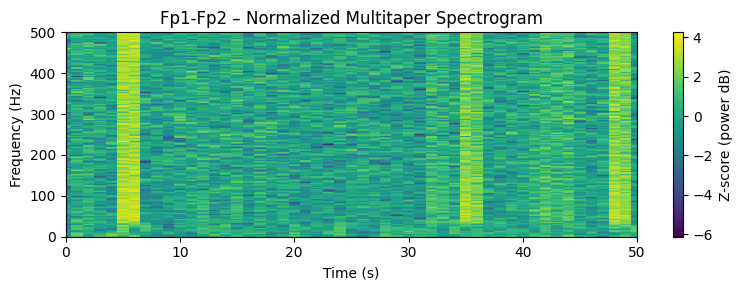

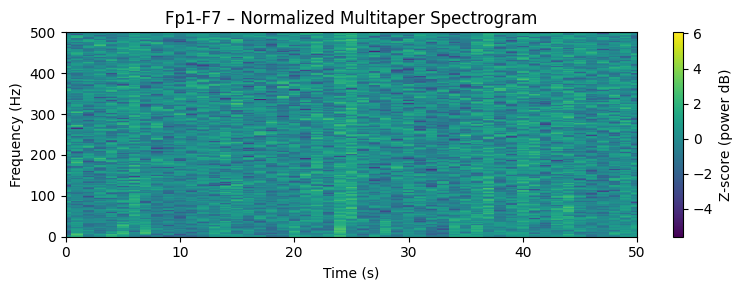

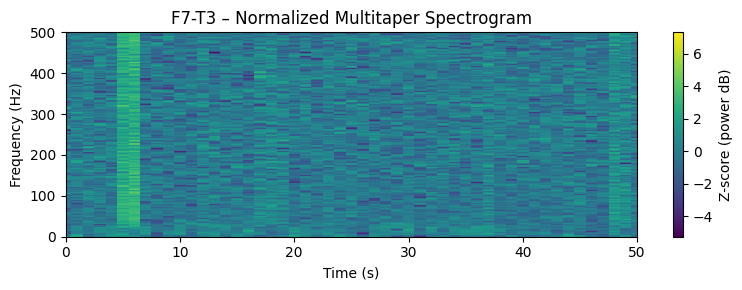

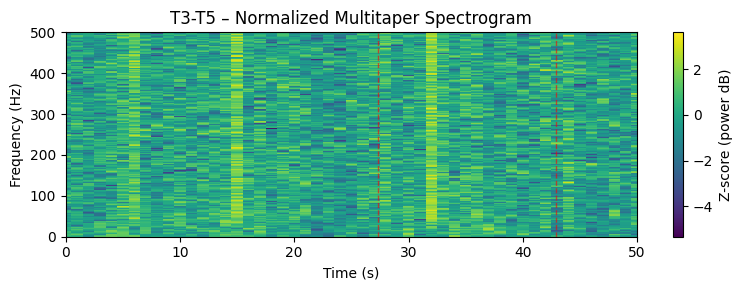

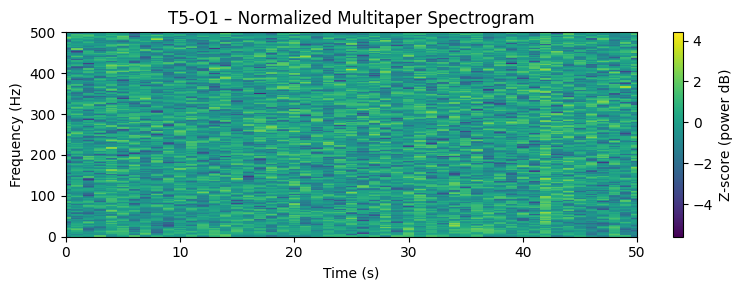

...

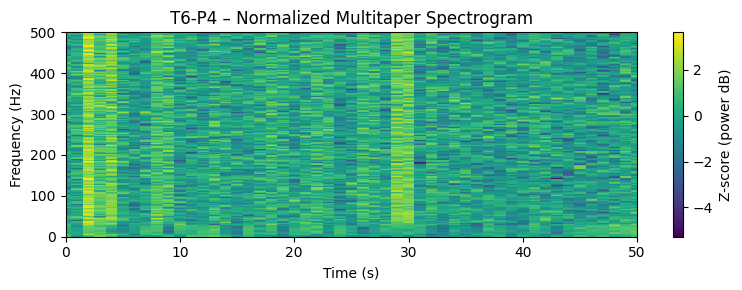

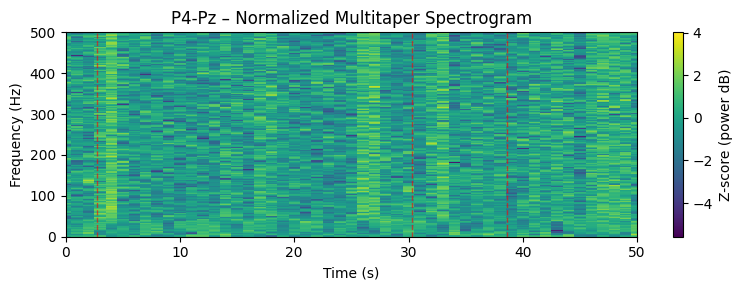

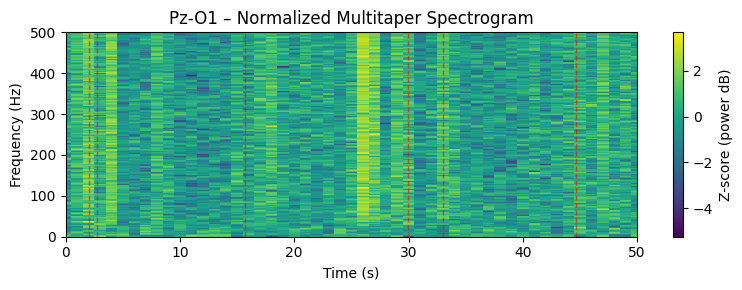

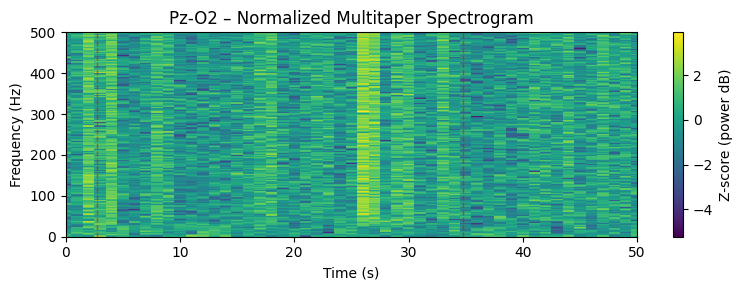

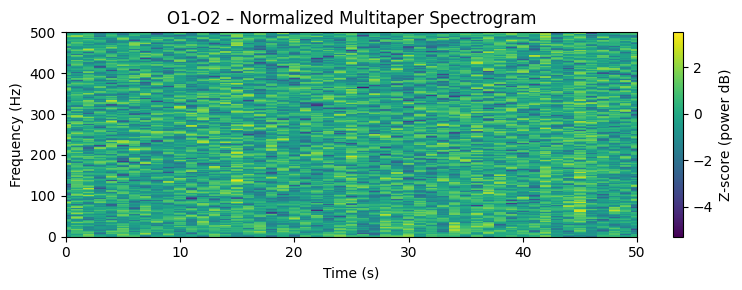

In [36]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from spectral_connectivity import Multitaper, Connectivity

# --- 0) Setup (assumes raw, data, chan_names are already defined) ---
fs = raw.info['sfreq']  # should be 2000
freq_limit = 500
tw_duration = 1.0
tw_step = 1.0
tb_product = 3.0

# --- Load HFO .tsv file ---
hfo_df = pd.read_csv("sub-01_ses-01_task-hfo_run-01_events.tsv", sep='\t')
hfo_df.rename(columns=lambda x: x.strip(), inplace=True)  # Remove trailing spaces
hfo_df["time_s"] = hfo_df["indStart"] / fs  # Convert start index to seconds
hfo_df.rename(columns={"strChannelName": "channel"}, inplace=True)

# --- 2) Loop through channels (up to first 36) ---
for ch_idx, ch_name in enumerate(chan_names[:36]):
    signal = data[ch_idx, :]

    # 2a) Build Multitaper object
    mt = Multitaper(
        signal,
        sampling_frequency=fs,
        time_halfbandwidth_product=tb_product,
        time_window_duration=tw_duration,
        time_window_step=tw_step,
        start_time=0.0
    )

    # 2b) Compute connectivity
    conn = Connectivity.from_multitaper(mt)

    # 2c) Extract spectrogram data
    power = conn.power().squeeze().T
    freqs = conn.frequencies
    times_spec = conn.time

    # 2d) Normalize
    power_db = 10 * np.log10(power)
    mean_per_f = power_db.mean(axis=1, keepdims=True)
    std_per_f = power_db.std(axis=1, keepdims=True)
    power_norm = (power_db - mean_per_f) / std_per_f

    # 2e) Plot
    fig, ax = plt.subplots(figsize=(8, 3))
    im = ax.pcolormesh(times_spec, freqs, power_norm, shading='auto')
    ax.set_title(f"{ch_name} – Normalized Multitaper Spectrogram", fontsize=12)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Frequency (Hz)")
    ax.set_ylim(0, freq_limit)

    # --- Add HFO lines ---
    hfo_for_ch = hfo_df[hfo_df["channel"] == ch_name]
    for t in hfo_for_ch["time_s"]:
        ax.axvline(x=t, color='red', linestyle='--', linewidth=1, alpha=0.6)

    fig.colorbar(im, ax=ax, label="Z-score (power dB)")
    plt.xlim(0, 50)
    plt.tight_layout()
    plt.show()